# Topological Landscapes of Yield Curve Historical Data

In this notebook we apply the method presented in [Topological Data Analysis of Financial Time Series: Landscapes of Crashes by Gidea and Katz](https://www.sciencedirect.com/science/article/abs/pii/S0378437117309202) to Daily Treasury Real Yield Curve Rates. We follow the notation and idea of Gidea and Katz.

The method produces two time series of topological information generated by the $L^1$ norms of persistence landscapes in dimension 1 (loops) and in dimension 2 (holes) of moving point clouds. 

In [44]:
import pandas as pd
from pandas_datareader import data as pdr
import numpy as np
from datetime import datetime

from sklearn.decomposition import PCA
SEED = 42

import gudhi as gd
import gudhi.representations
from gudhi.representations import Landscape
import matplotlib.pyplot as plt

import scipy.integrate as integrate

import plotly.express as px

# Data Cleaning and Preprocessing

In [2]:
data = pd.read_csv('yield_curve_data.csv')

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7975 entries, 0 to 7974
Data columns (total 13 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    7975 non-null   object 
 1   1 Mo    5075 non-null   float64
 2   2 Mo    770 non-null    float64
 3   3 Mo    7971 non-null   float64
 4   6 Mo    7974 non-null   float64
 5   1 Yr    7974 non-null   float64
 6   2 Yr    7974 non-null   float64
 7   3 Yr    7974 non-null   float64
 8   5 Yr    7974 non-null   float64
 9   7 Yr    7974 non-null   float64
 10  10 Yr   7974 non-null   float64
 11  20 Yr   7035 non-null   float64
 12  30 Yr   6980 non-null   float64
dtypes: float64(12), object(1)
memory usage: 810.1+ KB


In [6]:
#convert 'Date' to datetime dtype
data['Date'] = data['Date'].apply(lambda d: datetime.strptime(d, '%m/%d/%y'))
#make date the index of data frame
data.set_index('Date', inplace = True)

The 1 and 2 month maturity variables have many missing values and will be discarded in this analysis. 

In [7]:
data.drop(['1 Mo', '2 Mo'], axis=1, inplace = True)

In [94]:
data

,3 Mo,6 Mo,1 Yr,2 Yr,3 Yr,5 Yr,7 Yr,10 Yr,20 Yr,30 Yr,top,top2,Ten_minus_Two,top1_variance
Date,,,,,,,,,,,,,,
1990-01-02,7.83,7.89,7.81,7.87,7.90,7.87,7.98,7.94,6.12,8.00,0.000000,0.0,0.07,NaN
1990-01-03,7.89,7.94,7.85,7.94,7.96,7.92,8.04,7.99,6.12,8.04,0.000000,0.0,0.05,NaN
1990-01-04,7.84,7.90,7.82,7.92,7.93,7.91,8.02,7.98,6.12,8.04,0.000000,0.0,0.06,NaN
1990-01-05,7.79,7.85,7.79,7.90,7.94,7.92,8.03,7.99,6.12,8.06,0.000000,0.0,0.09,NaN
1990-01-08,7.79,7.88,7.81,7.90,7.95,7.92,8.05,8.02,6.12,8.09,0.000000,0.0,0.12,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-05,0.05,0.07,0.14,0.39,0.66,1.04,1.30,1.45,1.88,1.87,1.840033,0.0,1.06,5.312726
2021-11-08,0.06,0.07,0.16,0.45,0.75,1.13,1.38,1.51,1.91,1.89,2.529936,0.0,1.06,5.312349
2021-11-09,0.04,0.06,0.14,0.41,0.71,1.08,1.32,1.46,1.86,1.83,2.551135,0.0,1.05,5.312025


We fill NaNs with the next valid observation to fill gap.

In [8]:
data.fillna(method="bfill", inplace = True)

Next we standarize the data

In [9]:
std_data = (data-data.mean())/data.std()

We use PCA to reduce the dimension of the data set.

In [10]:
pca = PCA(random_state = SEED)
pc = pca.fit_transform(std_data)

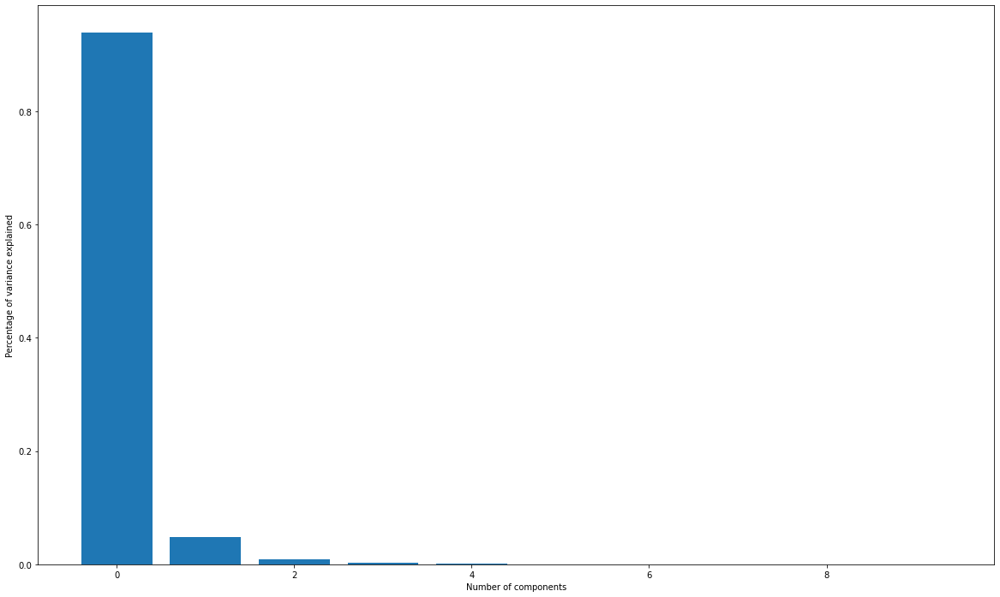

In [11]:
# Distribution of variance plot
n = std_data.shape[1]
x_axis = np.arange(n)
var_per = pca.explained_variance_ratio_
fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot()
ax.set_xlabel('Number of components')
ax.set_ylabel('Percentage of variance explained')
plt.bar(x_axis, var_per)
plt.show()

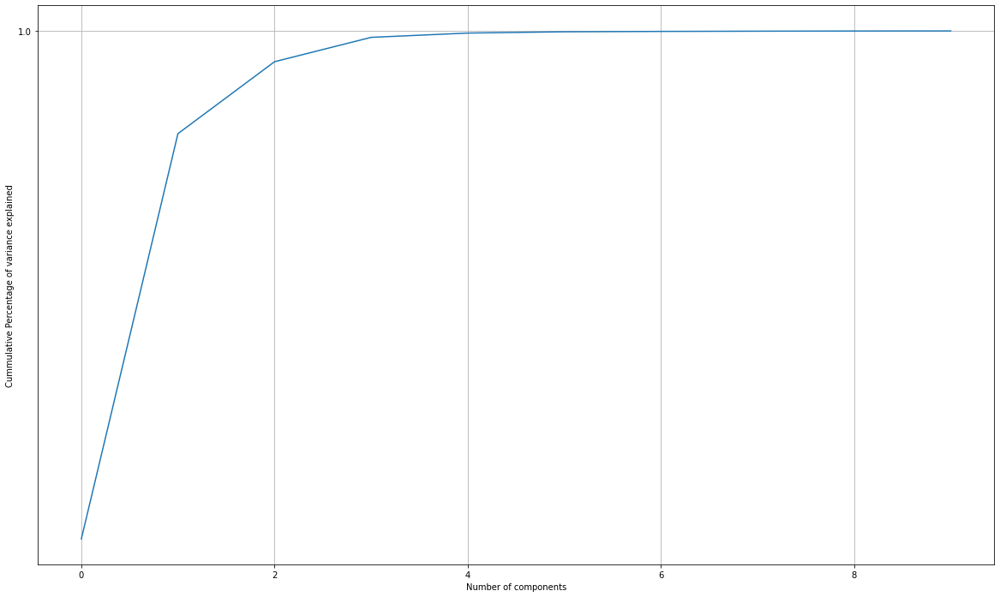

In [12]:
# sorted list of cummulative sums of explained variance
cumm_var = pca.explained_variance_ratio_.cumsum()
# plot to visualize the cummulative percentage of variance explained over the number of components
fig = plt.figure(figsize=(20, 12))
ax = fig.add_subplot()
ax.set_xlabel('Number of components')
ax.set_ylabel('Cummulative Percentage of variance explained')
ax.set_xticks(np.arange(0, 45, 2))
ax.set_yticks(np.arange(0,1.1, 0.1))
ax.grid()
plt.plot(cumm_var)
plt.show()

Since the first three principal components explain over 99% of the variance in the data set we'll use the projection of our original data set to these principal components and apply the Topological Landscapes method to this transformed data.

In [13]:
pca = PCA(n_components=3, random_state = SEED)
pc = pca.fit_transform(std_data)

In [14]:
pc_df = pd.DataFrame(data = pc, index = data.index)

In [15]:
pc_df.shape

(7975, 3)

## Time Series of Topological Landscapes

In our approach, the point cloud is formed by  $𝑤=50$  points in  $\mathbb{R}^3$ , where the coordinates of each point in  $\mathbb{R}^3$ represent the first three principal components of the daily yield curves. The sliding step is set to one day, which in the case under consideration yields a  $(7975−𝑤)$  time-ordered set of point clouds.

In [16]:
X_clouds = np.lib.stride_tricks.sliding_window_view(pc_df, window_shape = (50,3), axis = [0,1] )

### Landscapes of persistent loops

For each point cloud $X_n$ we compute the persistence diagram $P_1(X_n)$ of its Rips filtration $R(X_n,\epsilon)$, the corresponding persistence landscape in dimension 1, and its $L^1$-norm.

In [75]:
norms = []
n = X_clouds.shape[0]
for i in range(n):
    rips_complex = gd.RipsComplex(points=X_clouds[i][0]).create_simplex_tree(max_dimension=2)
    persistence_diagram = rips_complex.persistence()
    dim1_int = rips_complex.persistence_intervals_in_dimension(1)
    if len(dim1_int) == 0:
        norms.append(0)
    else:
        landscape = gd.representations.Landscape(num_landscapes=1, resolution=1000)
        l = landscape.fit_transform([rips_complex.persistence_intervals_in_dimension(1)])
        y = l[0][:1000]
        l1_norm = integrate.simps(y, x = None)
        norms.append(l1_norm)

We add the topological series to our original data frame.

In [76]:
#insert topological series into original data frame
data['top'] = np.insert(norms, 0 ,np.zeros(49))

In [77]:
def max_normalize(x):
    maximum = x.max()
    return x/maximum

In [95]:
fig = px.line(max_normalize(data))
fig.update_xaxes(rangeslider_visible=True)
fig.show()

### Landscapes of persistent 2D 'holes'

We replicate the method but in this case we focus on the second homology $H_2$. That is, we compute the persistence diagram $P_2(X_n)$ of the Rips filtration $R(X_n,\epsilon)$, the corresponding persistence landscape in dimension 2, and its $L^1$-norm.

In [79]:
norms2 = []
n = X_clouds.shape[0]
for i in range(n):
    rips_complex = gd.RipsComplex(points=X_clouds[i][0]).create_simplex_tree(max_dimension=3)
    persistence_diagram = rips_complex.persistence()
    dim2_int = rips_complex.persistence_intervals_in_dimension(2)
    if len(dim2_int) == 0:
        norms2.append(0)
    else:
        landscape = gd.representations.Landscape(num_landscapes=1, resolution=1000)
        l = landscape.fit_transform([dim2_int])
        y = l[0][:1000]
        l1_norm = integrate.simps(y, x = None)
        norms2.append(l1_norm)

In [80]:
data['top2'] = np.insert(norms2, 0 ,np.zeros(49))

To investigage any association of inverted yield curves and the topological series, we add a column of 10-Year minus 2-Year.

In [84]:
data['Ten_minus_Two'] = data['10 Yr'] - data['2 Yr']

In [86]:
fig = px.line(max_normalize(data))
fig.update_xaxes(rangeslider_visible=True)
fig.show()

### Year 2000 negative 10yr-2yr

We quantify temporal variations in the persistence of loops in the time-ordered set of point clouds prior to 2000 where the 10yr-2yr is negative.

In [87]:
rolling_window = 500

In [89]:
#500 day rolling variance
top1_variance = data.top.rolling(window= rolling_window).var()
data['top1_variance'] = top1_variance

In [93]:
fig = px.line(max_normalize(data['02-01-1999':'02-01-2000']))
fig.update_xaxes(rangeslider_visible=True)
fig.show()